Flight demand throughout the year.

In [1]:
# Import the dependencies
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import hvplot.pandas
import requests
from pprint import pprint

In [2]:
# Read the CSV file
file_path = Path("Data/CSV/cleaned_flight_data.csv")

In [3]:
# Create a DataFrame
df = pd.read_csv(file_path)

# Display the DataFrame
df.head()

,tbl,Year,quarter,departure_city_id,arrival_city_id,departure_city,arrival_city,departure_airport_id,arrival_airport_id,departure_airport,...,large_ms,fare_lg,carrier_low,lf_ms,fare_low,tbl1apk,departure_latitude,departure_longitude,arrival_latitude,arrival_longitude
0,Table 1a,2010,1,34614,33195,"Salt Lake City, UT","Tampa, FL (Metropolitan Area)",14869,15304,SLC,...,0.38,247.69,US Airways Group Inc.,0.20,166.99,201011486915304SLCTPA,40.758478,-111.888142,37.860600,-78.804199
1,Table 1a,1998,4,30189,31703,"Colorado Springs, CO","New York City, NY (Metropolitan Area)",11109,12197,COS,...,0.73,292.60,Northwest Airlines Inc.,0.24,248.27,199841110912197COSHPN,38.835224,-104.819798,40.123164,-75.333718
2,Table 1a,1998,4,30198,30852,"Pittsburgh, PA","Washington, DC (Metropolitan Area)",14122,10821,PIT,...,0.93,245.70,Continental Airlines Inc.,0.03,71.30,199841412210821PITBWI,40.442169,-79.994945,38.892062,-77.019912
3,Table 1a,2009,3,32211,32575,"Las Vegas, NV","Los Angeles, CA (Metropolitan Area)",12889,14908,LAS,...,0.58,118.28,US Airways Group Inc.,0.41,102.75,200931288914908LASSNA,36.169202,-115.140597,34.052238,-118.243344
4,Table 1a,1993,4,30255,30852,"Huntsville, AL","Washington, DC (Metropolitan Area)",12217,12264,HSV,...,0.48,275.50,United Air Lines Inc.,0.25,197.69,199341221712264HSVIAD,34.729538,-86.585283,38.892062,-77.019912


In [4]:
# Group the data by year and quarter
grouped_df = df.groupby(["Year", "quarter"])

# Display the first 5 rows of the grouped DataFrame
grouped_df.apply(lambda x: x.head())

/var/folders/j1/3lk4c0b17lxc6lhdy94ylbw80000gn/T/ipykernel_11334/1703976893.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  grouped_df.apply(lambda x: x.head())


tbl  Year  quarter  departure_city_id  \
Year quarter                                                      
1993 1       11      Table 1a  1993        1              31453   
             41      Table 1a  1993        1              30599   
             49      Table 1a  1993        1              31703   
             62      Table 1a  1993        1              33570   
             101     Table 1a  1993        1              32467   
...                       ...   ...      ...                ...   
2020 2       203394   Table1a  2020        2              30135   
             203395   Table1a  2020        2              30135   
             203396   Table1a  2020        2              30140   
             203397   Table1a  2020        2              30140   
             203398   Table1a  2020        2              30140   

                     arrival_city_id                         departure_city  \
Year quarter                                                                  
1993 1       11                32457                            Houston, TX   
             41                32575                         Birmingham, AL   
             49                34524  New York City, NY (Metropolitan Area)   
             62                30852                          San Diego, CA   
             101               33342          Miami, FL (Metropolitan Area)   
...                              ...                                    ...   
2020 2       203394            33195         Allentown/Bethlehem/Easton, PA   
             203395            33195         Allentown/Bethlehem/Easton, PA   
             203396            32575                        Albuquerque, NM   
             203397            30852                        Albuquerque, NM   
             203398            30194                        Albuquerque, NM   

                                              arrival_city  \
Year quarter                                                 
1993 1       11      San Francisco, CA (Metropolitan Area)   
             41        Los Angeles, CA (Metropolitan Area)   
             49                               Richmond, VA   
             62         Washington, DC (Metropolitan Area)   
             101                             Milwaukee, WI   
...                                                    ...   
2020 2       203394          Tampa, FL (Metropolitan Area)   
             203395          Tampa, FL (Metropolitan Area)   
             203396    Los Angeles, CA (Metropolitan Area)   
             203397     Washington, DC (Metropolitan Area)   
             203398                  Dallas/Fort Worth, TX   

                     departure_airport_id  arrival_airport_id  \
Year quarter                                                    
1993 1       11                     12266               13796   
             41                     10599               12954   
             49                     15070               14524   
             62                     14679               11278   
             101                    13303               13342   
...                                   ...                 ...   
2020 2       203394                 10135               14112   
             203395                 10135               15304   
             203396                 10140               10800   
             203397                 10140               10821   
             203398                 10140               11259   

                    departure_airport  ... large_ms  fare_lg  \
Year quarter                           ...                     
1993 1       11                   IAH  ...   0.6400   230.26   
             41                   BHM  ...   1.0000   290.64   
             49                   SWF  ...   0.8100   178.83   
             62                   SAN  ...   0.2600   343.23   
             101                  MIA  ...   0.5400   155.89   
...                      

In [5]:
# Get the number of flights for each quarter
flights_per_quarter = grouped_df["quarter"].count()

# Display the number of flights for each quarter
flights_per_quarter

Year  quarter
1993  1          2377
      2          2436
      3          2433
      4          2418
1994  1          2388
                 ... 
2018  1          2017
      2          2043
2019  3          2050
2020  1          2002
      2          1795
Name: quarter, Length: 98, dtype: int64

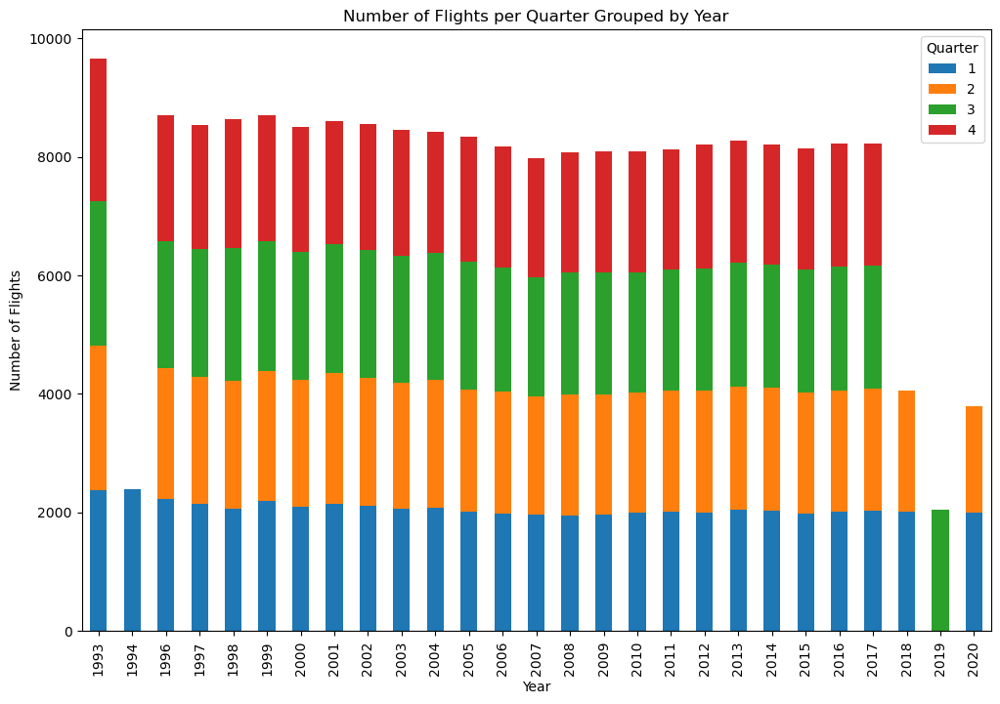

In [6]:
# Graph a bar chart of the number of flights for each quarter
flights_per_quarter.unstack().plot(kind='bar', stacked=True, figsize=(12, 8))
plt.title('Number of Flights per Quarter Grouped by Year')
plt.xlabel('Year')
plt.ylabel('Number of Flights')
plt.legend(title='Quarter')

# Save the chart as a PNG file
output_file_path = Path("Data/Images/flights_stacked_per_quarter.png")
plt.savefig(output_file_path)

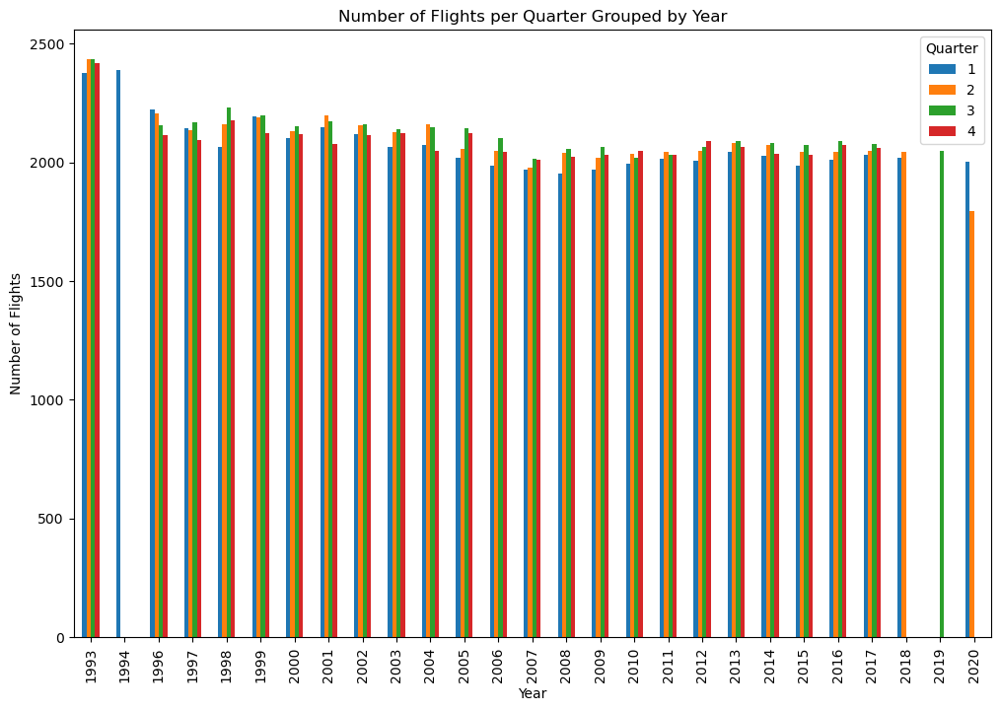

In [7]:
# Graph a bar chart of the number of flights for each quarter with quarters beside each other
flights_per_quarter.unstack().plot(kind='bar', stacked=False, figsize=(12, 8))
plt.title('Number of Flights per Quarter Grouped by Year')
plt.xlabel('Year')
plt.ylabel('Number of Flights')
plt.legend(title='Quarter')

# Save the chart as a PNG file
output_file_path = Path("Data/Images/flights_unstacked_per_quarter.png")
plt.savefig(output_file_path)

In [8]:
# Get the numbers of flights per quarter for each year
total_flights_per_quarter = flights_per_quarter.unstack()
total_flights_per_quarter.dropna(inplace=True)

# Display the number of flights per quarter for each year
total_flights_per_quarter

quarter,1,2,3,4
Year,,,,
1993,2377.0,2436.0,2433.0,2418.0
1996,2223.0,2204.0,2155.0,2116.0
1997,2143.0,2137.0,2168.0,2093.0
1998,2064.0,2162.0,2229.0,2178.0
1999,2192.0,2189.0,2196.0,2122.0
2000,2103.0,2133.0,2151.0,2117.0
2001,2149.0,2199.0,2171.0,2077.0
2002,2117.0,2155.0,2162.0,2114.0
2003,2063.0,2125.0,2140.0,2121.0


In [9]:
# Sort the DataFrame by quarter totals while keeping the quarter columns
sorted_quarters = total_flights_per_quarter.sum().sort_values(ascending=False)

# Display the sorted quarters
sorted_quarters

quarter
3    48850.0
2    48463.0
4    48069.0
1    47512.0
dtype: float64

In [10]:
# Create an empty dictionary to hold the quarter totals
quarter_totals = {}

# Loop through the sorted quarters and add the totals to the dictionary
for quarter in sorted_quarters.index:
    quarter_totals[quarter] = sorted_quarters[quarter]

# Display the quarter totals
for key, value in quarter_totals.items():
    print(f"Quarter {key}: {value:,.2f} flights")

Quarter 3: 48,850.00 flights
Quarter 2: 48,463.00 flights
Quarter 4: 48,069.00 flights
Quarter 1: 47,512.00 flights


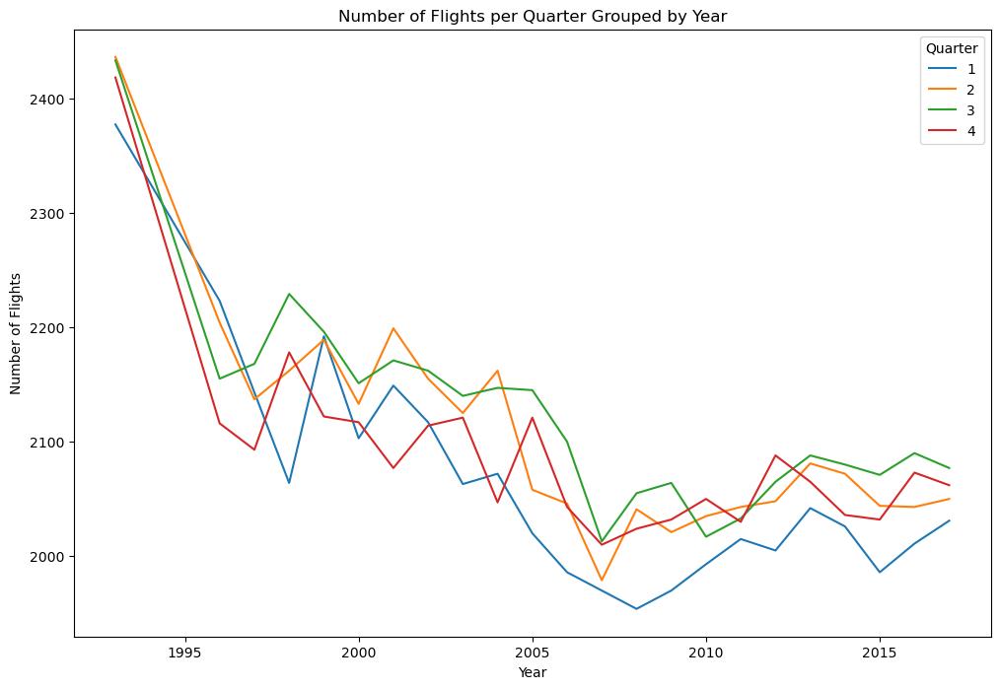

In [11]:
# Create a line chart of the number of flights for each quarter
total_flights_per_quarter.plot(kind='line', figsize=(12, 8))
plt.title('Number of Flights per Quarter Grouped by Year')
plt.xlabel('Year')
plt.ylabel('Number of Flights')
plt.legend(title='Quarter')

# Save the chart as a PNG file
output_file_path = Path("Data/Images/flights_per_year_by_quarter.png")
plt.savefig(output_file_path)

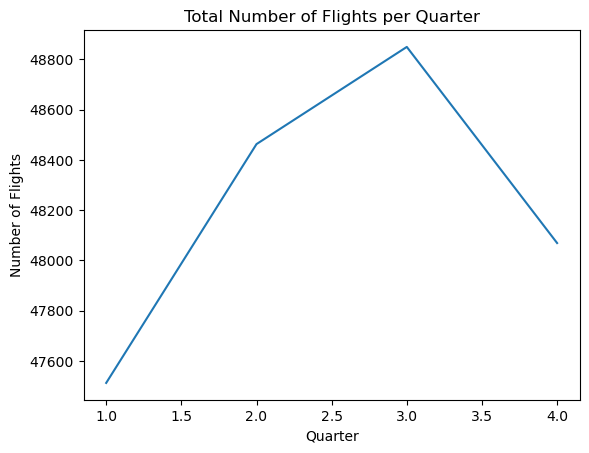

In [12]:
# Plot the quarter_totals dictionary as a as a line chart
quarter_totals = dict(sorted(quarter_totals.items()))
plt.plot(quarter_totals.keys(), quarter_totals.values())
plt.title('Total Number of Flights per Quarter')
plt.xlabel('Quarter')
plt.ylabel('Number of Flights')

# Save the chart as a PNG file
output_file_path = Path("Data/Images/total_flights_per_quarter.png")
plt.savefig(output_file_path)

What routes are most profitable?

In [13]:
# Open the csv data file
csv_path = Path("Data/CSV/cleaned_flight_data.csv")

In [14]:
# Create a DataFrame from the csv data
df = pd.read_csv(csv_path)

# Display the first 5 rows of the DataFrame
df.head()

,tbl,Year,quarter,departure_city_id,arrival_city_id,departure_city,arrival_city,departure_airport_id,arrival_airport_id,departure_airport,...,large_ms,fare_lg,carrier_low,lf_ms,fare_low,tbl1apk,departure_latitude,departure_longitude,arrival_latitude,arrival_longitude
0,Table 1a,2010,1,34614,33195,"Salt Lake City, UT","Tampa, FL (Metropolitan Area)",14869,15304,SLC,...,0.38,247.69,US Airways Group Inc.,0.20,166.99,201011486915304SLCTPA,40.758478,-111.888142,37.860600,-78.804199
1,Table 1a,1998,4,30189,31703,"Colorado Springs, CO","New York City, NY (Metropolitan Area)",11109,12197,COS,...,0.73,292.60,Northwest Airlines Inc.,0.24,248.27,199841110912197COSHPN,38.835224,-104.819798,40.123164,-75.333718
2,Table 1a,1998,4,30198,30852,"Pittsburgh, PA","Washington, DC (Metropolitan Area)",14122,10821,PIT,...,0.93,245.70,Continental Airlines Inc.,0.03,71.30,199841412210821PITBWI,40.442169,-79.994945,38.892062,-77.019912
3,Table 1a,2009,3,32211,32575,"Las Vegas, NV","Los Angeles, CA (Metropolitan Area)",12889,14908,LAS,...,0.58,118.28,US Airways Group Inc.,0.41,102.75,200931288914908LASSNA,36.169202,-115.140597,34.052238,-118.243344
4,Table 1a,1993,4,30255,30852,"Huntsville, AL","Washington, DC (Metropolitan Area)",12217,12264,HSV,...,0.48,275.50,United Air Lines Inc.,0.25,197.69,199341221712264HSVIAD,34.729538,-86.585283,38.892062,-77.019912


In [15]:
# Group the data by departure and arrival airports
grouped_routes = df.groupby(['departure_airport', 'arrival_airport'])

# Display the first 5 rows of the grouped data
grouped_routes.apply(lambda x: x.head())

/var/folders/j1/3lk4c0b17lxc6lhdy94ylbw80000gn/T/ipykernel_11334/1800778213.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  grouped_routes.apply(lambda x: x.head())


tbl  Year  quarter  \
departure_airport arrival_airport                                   
ABE               CHI             129481  Table 1a  1994        1   
                                  137455  Table 1a  1993        2   
                                  139130  Table 1a  1993        3   
                                  159206  Table 1a  1993        1   
                                  166795  Table 1a  1993        4   
...                                            ...   ...      ...   
XNA               SWF             8686    Table 1a  2005        1   
                                  11891   Table 1a  2009        4   
                                  12427   Table 1a  2008        3   
                                  17138   Table 1a  2002        2   
                                  18316   Table 1a  2011        1   

                                          departure_city_id  arrival_city_id  \
departure_airport arrival_airport                                              
ABE               CHI             129481              30135            30977   
                                  137455              30135            30977   
                                  139130              30135            30977   
                                  159206              30135            30977   
                                  166795              30135            30977   
...                                                     ...              ...   
XNA               SWF             8686                31834            31703   
                                  11891               31834            31703   
                                  12427               31834            31703   
                                  17138               31834            31703   
                                  18316               31834            31703   

                                                          departure_city  \
departure_airport arrival_airport                                          
ABE               CHI             129481  Allentown/Bethlehem/Easton, PA   
                                  137455  Allentown/Bethlehem/Easton, PA   
                                  139130  Allentown/Bethlehem/Easton, PA   
                                  159206  Allentown/Bethlehem/Easton, PA   
                                  166795  Allentown/Bethlehem/Easton, PA   
...                                                                  ...   
XNA               SWF             8686                  Fayetteville, AR   
                                  11891                 Fayetteville, AR   
                                  12427                 Fayetteville, AR   
                                  17138                 Fayetteville, AR   
                                  18316                 Fayetteville, AR   

                                                                   arrival_city  \
departure_airport arrival_airport                                                 
ABE               CHI             129481                            Chicago, IL   
                                  137455                            Chicago, IL   
                                  139130                            Chicago, IL   
                                  159206                            Chicago, IL   
                                  166795                            Chicago, IL   
...                                                                         ...   
XNA               SWF             8686    New York City, NY (Metropolitan Area)   
                                  11891   New York City, NY (Metropolitan Area)   
                                  12427   New York City, NY (Metropolitan Area)   
                                  17138   New York City, NY (Metropolitan Area)   
                                  18316   New York City, NY (Metropolitan Area)   

                                       

In [16]:
# Get the number of flights for each route
route_counts = grouped_routes[['departure_airport', 'arrival_airport', 'passengers']].count()

# Display the first 50 rows of the route counts
route_counts.head(50)

departure_airport  arrival_airport  \
departure_airport arrival_airport                                       
ABE               CHI                              5                5   
                  MCO                              5                5   
                  MDW                             15               15   
                  ORD                             15               15   
                  PIE                              5                5   
                  TPA                              5                5   
ABQ               BOS                             90               90   
                  BUR                             98               98   
                  BWI                             98               98   
                  CHI                             14               14   
                  DAL                             98               98   
                  DCA                             98               98   
                  DET                              1                1   
                  DFW                             98               98   
                  DTW                              2                2   
                  EFD                             33               33   
                  EWR                             98               98   
                  FLL                              5                5   
                  HOU                             98               98   
                  HPN                             97               97   
                  IAD                             98               98   
                  IAH                             98               98   
                  ISP                             98               98   
                  JFK                             98               98   
                  LAS                              3                3   
                  LAX                             98               98   
                  LGA                             98               98   
                  LGB                             98               98   
                  MCI                             35               35   
                  MDW                             98               98   
                  MHT                             90               90   
                  MIA                              5                5   
                  MSP                              1                1   
                  NYC                             15               15   
                  OAK                             98               98   
                  ONT                             98               98   
                  ORD                             98               98   
                  PHX                             45               45   
                  PVD                             90               90   
                  SEA                              2                2   
                  SFO                             98               98   
                  SJC                             98               98   
                  SMF                              6                6   
                  SNA                             98               98   
                  SWF                             96               96   
                  TPA                              5                5   
                  WAS                             14               14   
ACK               EWR                             16               16   
                  HPN                             13               13   
                  ISP                              2                2   

                                   passengers  
departure_airport arrival_airport              
ABE               CHI                       5  
                  MCO                       5  
                  MDW                      15 

In [17]:
# Get the total fares for each route
route_fares = grouped_routes['fare'].sum() * grouped_routes['passengers'].sum()

# Display the first 50 rows of the route fares
route_fares.head(50)

departure_airport  arrival_airport
ABE                CHI                5.936480e+03
                   MCO                1.137370e+06
                   MDW                1.330739e+05
                   ORD                8.498779e+06
                   PIE                2.531174e+05
                   TPA                1.492700e+05
ABQ                BOS                3.233614e+08
                   BUR                1.280507e+08
                   BWI                5.180366e+08
                   CHI                3.992086e+04
                   DAL                7.204495e+08
                   DCA                5.164899e+08
                   DET                2.517880e+03
                   DFW                3.865036e+08
                   DTW                8.116416e+04
                   EFD                3.310034e+05
                   EWR                3.126201e+08
                   FLL                4.246105e+05
                   HOU                3.363736e

In [18]:
# Sort the route fares from highest to lowest
sorted_route_fares = route_fares.sort_values(ascending=False)

# Display the first 50 rows of the sorted route fares
sorted_route_fares.head(50)

departure_airport  arrival_airport
LAX                JFK                1.706937e+10
JFK                SFO                1.234292e+10
ORD                LGA                7.952892e+09
BOS                SFO                7.157493e+09
EWR                SFO                7.114536e+09
LAX                EWR                6.911173e+09
ORD                LAX                6.745578e+09
                   SFO                6.177967e+09
ATL                LGA                6.111065e+09
BOS                LAX                5.692233e+09
DFW                LGA                5.584718e+09
SFO                IAD                5.437013e+09
LAX                IAD                5.217642e+09
ORD                DFW                4.849745e+09
                   EWR                4.777549e+09
ATL                LAX                4.686955e+09
BOS                LGA                4.507842e+09
                   ORD                4.363765e+09
LAX                SFO                4.281535e

In [19]:
# Create an empty dictionary to store the fares data
fares_data = {}

# Loop through the sorted route fares
for route in sorted_route_fares.index:
    # Get the route name
    route_name = route[0] + "-" + route[1]
    # Get the total fare for the route
    total_fare = sorted_route_fares[route]
    # Add the route and total fare to the fares data
    fares_data[route_name] = total_fare

In [20]:
# Return the top 10 routes with the highest total fares
top_10_routes = dict(list(fares_data.items())[0:10])
for route, fare in top_10_routes.items():
    print(f"{route}: ${fare:,.2f}")

LAX-JFK: $17,069,366,187.48
JFK-SFO: $12,342,920,693.84
ORD-LGA: $7,952,891,598.28
BOS-SFO: $7,157,493,317.36
EWR-SFO: $7,114,535,897.52
LAX-EWR: $6,911,172,558.72
ORD-LAX: $6,745,578,207.84
ORD-SFO: $6,177,967,330.08
ATL-LGA: $6,111,064,595.95
BOS-LAX: $5,692,233,083.40


/var/folders/j1/3lk4c0b17lxc6lhdy94ylbw80000gn/T/ipykernel_11334/3659487604.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(['${:,.0f}'.format(x) for x in ax.get_yticks()])


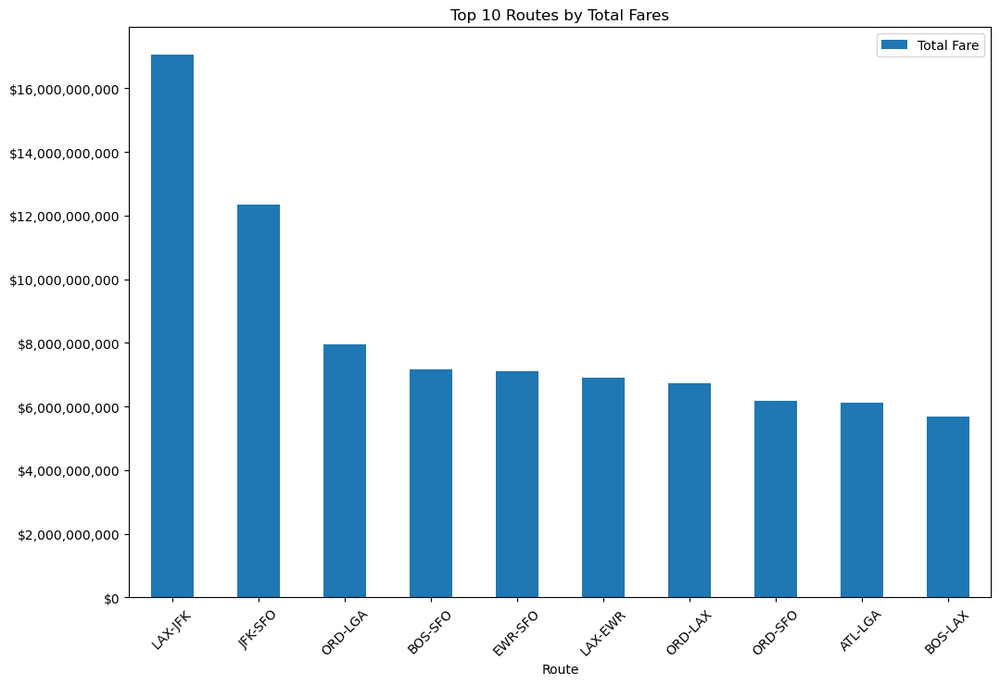

In [21]:
# Graph the top 10 routes with the highest total fares
top_10_routes_df = pd.DataFrame(list(top_10_routes.items()), columns=['Route', 'Total Fare'])
ax = top_10_routes_df.plot(kind='bar', x='Route', y='Total Fare', title='Top 10 Routes by Total Fares', rot=45)
ax.set_yticklabels(['${:,.0f}'.format(x) for x in ax.get_yticks()])

# Save the graph as a png file
fig = ax.get_figure()
fig.set_size_inches(12, 8)
plt.savefig("Data/Images/top_10_routes_by_total_fares.png");

In [22]:
# Return the lowest 10 routes with the lowest total fares
lowest_10_routes = dict(list(fares_data.items())[-10:])
for route, fare in lowest_10_routes.items():
    print(f"{route}: ${fare:,.2f}")

FLL-TSS: $0.00
BZN-SWF: $0.00
FMY-BDL: $0.00
FMY-DCA: $0.00
FMY-JFK: $0.00
DAL-XNA: $0.00
CAE-LGB: $0.00
FTW-SFO: $0.00
MHT-SWF: $0.00
ORD-HFD: $0.00


In [23]:
# Define the path to the file
flight_data = Path("Data/CSV/cleaned_flight_data.csv")

# Read the data from the file
flight_data_df = pd.read_csv(flight_data)
flight_data_df.head()

,tbl,Year,quarter,departure_city_id,arrival_city_id,departure_city,arrival_city,departure_airport_id,arrival_airport_id,departure_airport,...,large_ms,fare_lg,carrier_low,lf_ms,fare_low,tbl1apk,departure_latitude,departure_longitude,arrival_latitude,arrival_longitude
0,Table 1a,2010,1,34614,33195,"Salt Lake City, UT","Tampa, FL (Metropolitan Area)",14869,15304,SLC,...,0.38,247.69,US Airways Group Inc.,0.20,166.99,201011486915304SLCTPA,40.758478,-111.888142,37.860600,-78.804199
1,Table 1a,1998,4,30189,31703,"Colorado Springs, CO","New York City, NY (Metropolitan Area)",11109,12197,COS,...,0.73,292.60,Northwest Airlines Inc.,0.24,248.27,199841110912197COSHPN,38.835224,-104.819798,40.123164,-75.333718
2,Table 1a,1998,4,30198,30852,"Pittsburgh, PA","Washington, DC (Metropolitan Area)",14122,10821,PIT,...,0.93,245.70,Continental Airlines Inc.,0.03,71.30,199841412210821PITBWI,40.442169,-79.994945,38.892062,-77.019912
3,Table 1a,2009,3,32211,32575,"Las Vegas, NV","Los Angeles, CA (Metropolitan Area)",12889,14908,LAS,...,0.58,118.28,US Airways Group Inc.,0.41,102.75,200931288914908LASSNA,36.169202,-115.140597,34.052238,-118.243344
4,Table 1a,1993,4,30255,30852,"Huntsville, AL","Washington, DC (Metropolitan Area)",12217,12264,HSV,...,0.48,275.50,United Air Lines Inc.,0.25,197.69,199341221712264HSVIAD,34.729538,-86.585283,38.892062,-77.019912


In [24]:
flight_data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205189 entries, 0 to 205188
Data columns (total 25 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   tbl                   205189 non-null  object 
 1   Year                  205189 non-null  int64  
 2   quarter               205189 non-null  int64  
 3   departure_city_id     205189 non-null  int64  
 4   arrival_city_id       205189 non-null  int64  
 5   departure_city        205189 non-null  object 
 6   arrival_city          205189 non-null  object 
 7   departure_airport_id  205189 non-null  int64  
 8   arrival_airport_id    205189 non-null  int64  
 9   departure_airport     205189 non-null  object 
 10  arrival_airport       205189 non-null  object 
 11  nsmiles               205189 non-null  int64  
 12  passengers            205189 non-null  int64  
 13  fare                  205189 non-null  float64
 14  carrier_lg            205189 non-null  object 
 15  

In [25]:
flight_data_df.columns

Index(['tbl', 'Year', 'quarter', 'departure_city_id', 'arrival_city_id',
       'departure_city', 'arrival_city', 'departure_airport_id',
       'arrival_airport_id', 'departure_airport', 'arrival_airport', 'nsmiles',
       'passengers', 'fare', 'carrier_lg', 'large_ms', 'fare_lg',
       'carrier_low', 'lf_ms', 'fare_low', 'tbl1apk', 'departure_latitude',
       'departure_longitude', 'arrival_latitude', 'arrival_longitude'],
      dtype='object')

In [26]:
departure_airport = flight_data_df['departure_airport'].unique()
print(len(departure_airport))

178


In [27]:
arrival_airport =flight_data_df['arrival_airport'].unique()
print(len(arrival_airport))

163


In [28]:
departure_city = flight_data_df['departure_city'].unique()
print(len(departure_city))

136


In [29]:
arrival_city = flight_data_df['arrival_city'].unique()
print(len(arrival_city))

121


In [30]:
# Compute the correlation matrix for the relevant columns
correlation_matrix = flight_data_df[['large_ms', 'fare_lg', 'lf_ms', 'fare_low']].corr()
print("Correlation Matrix:\n", correlation_matrix)

Correlation Matrix:
           large_ms   fare_lg     lf_ms  fare_low
large_ms  1.000000 -0.178920  0.521937 -0.091604
fare_lg  -0.178920  1.000000 -0.235000  0.839224
lf_ms     0.521937 -0.235000  1.000000  0.041644
fare_low -0.091604  0.839224  0.041644  1.000000


### Correlation Matrix:
The correlation matrix shows relationships between market shares and fares:

- `large_ms` and `fare_lg`: Weak negative correlation of -0.18.
- `lf_ms` and `fare_lg`: Negative correlation of -0.24.
- `fare_lg` and `fare_low`: Strong positive correlation of 0.84.

In [31]:
# Fixing the code
highest_fare = flight_data_df[['fare_lg', 'fare_low']].max()
lowest_fare = flight_data_df[['fare_lg', 'fare_low']].min()
average_fare = flight_data_df[['fare_lg', 'fare_low']].mean()

print("Highest Fares:\n", highest_fare)
print("Lowest Fares:\n", lowest_fare)
print("Average Fares:\n", average_fare)

Highest Fares:
 fare_lg     2725.6
fare_low    2725.6
dtype: float64
Lowest Fares:
 fare_lg     50.0
fare_low    50.0
dtype: float64
Average Fares:
 fare_lg     216.240639
fare_low    188.975523
dtype: float64


### Fare Distribution:
- The highest fares for both the largest and lowest carriers are the same (2725.6), which is unusual but could be a dataset characteristic.
- The lowest fares for both carriers are identical (50.0).
- Average fares differ slightly: the largest carrier charges an average of 216.24, while the lowest fare carrier charges 188.98.

In [32]:
# Correlation between fare and passengers (demand)
correlation_fare_passengers = flight_data_df[['fare', 'passengers']].corr()
print("\nCorrelation between fare and passengers:\n", correlation_fare_passengers)


Correlation between fare and passengers:
                fare  passengers
fare        1.00000    -0.19278
passengers -0.19278     1.00000


### Correlation between Fare and Passengers:
- The correlation of -0.19278 suggests a weak negative relationship between fare and passengers. 
- As fare increases, the number of passengers tends to decrease slightly, but the correlation is not strong.

### Final Summary:
- The correlation between fare and passengers is weak, indicating that price increases do not significantly decrease passenger numbers.
- Fare statistics reveal that while both largest and lowest carriers have identical highest and lowest fares, their average fares differ slightly.

In [33]:
year = flight_data_df["Year"].unique()
print(len(year))

27


### Calculate Flight Demand by Year and Quarter

In [34]:

#Group the data by Year and Quarter, summing the passengers
flight_demand_by_year_quarter = flight_data_df.groupby(['Year', 'quarter'])['passengers'].sum()

# Step 3: Find the year with the highest flight demand (highest sum of passengers)
best_demand_year = flight_demand_by_year_quarter.groupby('Year').sum().idxmax()
best_demand_year_sales = flight_demand_by_year_quarter.groupby('Year').sum().max()

# Step 4: Find the quarter with the highest flight demand within the best year
best_demand_quarter = flight_demand_by_year_quarter[best_demand_year].idxmax()
best_demand_quarter_sales = flight_demand_by_year_quarter[best_demand_year].max()

# Output the results
print(f"The year with the highest flight demand was {best_demand_year} with total passengers of {best_demand_year_sales}.")
print(f"The quarter with the highest flight demand in {best_demand_year} was Q{best_demand_quarter} with passengers {best_demand_quarter_sales}.")

The year with the highest flight demand was 2017 with total passengers of 3086637.
The quarter with the highest flight demand in 2017 was Q2 with passengers 813003.


Flight Demand Analysis:

- **Year with Highest Flight Demand**: 2017 with 3,086,637 passengers.
- **Quarter with Highest Flight Demand in 2017**: Q2 (April - June) with 813,003 passengers.

**Statistical Insight**: 
The highest flight demand in 2017 occurred in Q2, which could be due to increased travel during summer vacation months, business travel, or public holidays. These periods often see a surge in passengers.

### Calculate Revenue by Year and Quarter

In [35]:
# Calculate the total revenue per record (fare * passengers)
flight_data_df['revenue'] = flight_data_df['fare'] * flight_data_df['passengers']

# Group the data by Year and Quarter, summing the revenue
revenue_by_year_quarter = flight_data_df.groupby(['Year', 'quarter'])['revenue'].sum()

# Find the year with the highest revenue (best sales)
best_revenue_year = revenue_by_year_quarter.groupby('Year').sum().idxmax()
best_revenue_year_total = revenue_by_year_quarter.groupby('Year').sum().max()

# Find the quarter with the highest revenue within the best year
best_revenue_quarter = revenue_by_year_quarter[best_revenue_year].idxmax()
best_revenue_quarter_total = revenue_by_year_quarter[best_revenue_year].max()

# Output the results
print(f"The year with the best revenue was {best_revenue_year} with total revenue of {best_revenue_year_total}.")
print(f"The quarter with the best revenue in {best_revenue_year} was Q{best_revenue_quarter} with revenue {best_revenue_quarter_total}.")

The year with the best revenue was 2017 with total revenue of 632009964.4300001.
The quarter with the best revenue in 2017 was Q2 with revenue 171378275.99.


Revenue Analysis:
- Multiplying fare × passengers gives total revenue, which helps measure how much airlines earned from ticket sales rather than just looking at the number of flights or passengers alone.
- **Year with the Best Revenue**: 2017 with a total revenue of \$632,009,964.43.
- **Quarter with the Best Revenue in 2017**: Q2 (April - June) with a revenue of \$171,378,275.99.

**Statistical Insight**:
Q2 of 2017 generated the highest revenue, likely due to increased flight demand during the summer travel season. This suggests that airlines capitalize on peak travel times, offering more flights and possibly higher fares during such quarters. The significant revenue in Q2 emphasizes the importance of seasonal demand on airline profitability.

Top Airlines by Revenue in 2017

In [36]:
# finding which airline did the best in 2017 
# filter for 2017 data
data_2017 = flight_data_df[flight_data_df['Year'] == 2017]

# Group by airline (carrier_lg) and sum the revenue
airline_revenue_2017 = data_2017.groupby('carrier_lg')['revenue'].sum().reset_index()

# Sort by revenue in descending order
airline_revenue_2017 = airline_revenue_2017.sort_values(by='revenue', ascending=False)

# Display the top airlines with highest revenue in 2017
print("Top Airlines by Revenue in 2017:")
print(airline_revenue_2017.head(11))  # Show top 10 airlines

Top Airlines by Revenue in 2017:
                                carrier_lg       revenue
7                   Southwest Airlines Co.  1.679892e+08
3                   American Airlines Inc.  1.505850e+08
10                   United Air Lines Inc.  1.281970e+08
4                     Delta Air Lines Inc.  1.134274e+08
6                          JetBlue Airways  3.773637e+07
1                     Alaska Airlines Inc.  2.291833e+07
11                          Virgin America  3.457048e+06
5                   Frontier Airlines Inc.  3.283271e+06
2                            Allegiant Air  2.373924e+06
8                         Spirit Air Lines  1.534200e+06
9   Sun Country Airlines d/b/a MN Airlines  5.082213e+05


1. Southwest Airlines Co. - 167.99 million dollars
2. American Airlines Inc. - 150.59 million dollars
3. United Air Lines Inc. - 128.20 million dollars
4. Delta Air Lines Inc. - 113.43 million dollars
5. JetBlue Airways - 37.74 million dollars
6. Alaska Airlines Inc. - 22.92 million dollars
7. Virgin America - 3.46 million dollars
8. Frontier Airlines Inc. - 3.28 million dollars
9. Allegiant Air - 2.37 million dollars
10. Spirit Air Lines - 1.53 million dollars
11. Sun Country Airlines d/b/a MN Airlines - 0.51 million dollars

We are using carrier_lg because it represents the largest carrier by passengers for each flight route. This allows us to analyze which airlines generated the most revenue in 2017

Top Airlines by Revenue in 2017:

- **Top Airline by Revenue**: Southwest Airlines Co. with \$167.99 million in revenue.
- **Other Notable Airlines**:
    - American Airlines Inc. - \$150.59 million
    - United Air Lines Inc. - \$128.20 million
    - Delta Air Lines Inc. - \$113.43 million
    - JetBlue Airways - \$37.74 million

**Statistical Insight**:
Southwest Airlines led the revenue charts in 2017, generating almost \$168 million. This is indicative of their dominant market position. On the other hand, airlines like Sun Country and Spirit generated the least revenue, pointing to the impact of market share, route offerings, and operational strategies on airline earnings.

Final Summary:

- **Flight Demand**: The year 2017 and Q2 showed the highest flight demand, suggesting a peak travel season in the middle of the year.
- **Revenue**: 2017 also stands out for the highest revenue, with Q2 leading, reflecting the strong correlation between increased travel and higher airline earnings.
- **Airline Performance**: Southwest Airlines emerged as the top performer, highlighting the role of a large market share and efficient operations in driving revenue.

In [37]:
# Dependencies and Setup
import matplotlib.pyplot as plt



In [38]:
# Define the boundaries for the regions based on the U.S. Census system

# West (Mountain and Pacific Divisions)
west_df = flight_data_df[
    (flight_data_df[
        'arrival_longitude'] >= -125) & (flight_data_df['arrival_longitude'] < -105)]

# Create map plots for each region using hvplot
map_west2 = west_df.hvplot.points('arrival_longitude', 'arrival_latitude',
                                 geo=True,
                                 tiles='OSM',
                                 size='passengers',
                                 color='carrier_lg',
                                 alpha=0.5,
                                 hover_cols=['arrival_city', 'arrival_airport'],
                                 frame_width=700,
                                 frame_height=500)
map_west2


:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [arrival_longitude,arrival_latitude]   (carrier_lg,passengers,arrival_city,arrival_airport)

In [39]:
# Midwest (East North Central and West North Central Divisions)
midwest_df = flight_data_df[
    (flight_data_df[
        'arrival_longitude'] >= -105) & (flight_data_df['arrival_longitude'] < -85)]

map_midwest2 = midwest_df.hvplot.points('arrival_longitude', 'arrival_latitude',
                                      geo=True,
                                      tiles='OSM',
                                      size='passengers',
                                      color='carrier_lg',
                                      alpha=0.5,
                                      hover_cols=['arrival_city', 'arrival_airport'],
                                      frame_width=700,
                                      frame_height=500)

map_midwest2

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [arrival_longitude,arrival_latitude]   (carrier_lg,passengers,arrival_city,arrival_airport)

In [40]:
# Northeast (New England and Middle Atlantic Divisions)
northeast_df = flight_data_df[
    (flight_data_df[
        'arrival_longitude'] >= -85) & (flight_data_df['arrival_longitude'] < -65)]

map_northeast2 = northeast_df.hvplot.points('arrival_longitude', 'arrival_latitude',
                                          geo=True,
                                          tiles='OSM',
                                          size='passengers',
                                          color='carrier_lg',
                                          alpha=0.5,
                                          hover_cols=['arrival_city', 'arrival_airport'],
                                          frame_width=700,
                                          frame_height=500)

map_northeast2

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [arrival_longitude,arrival_latitude]   (carrier_lg,passengers,arrival_city,arrival_airport)

In [42]:
# Load the datasets
file_path_1 = Path("Data/US Airline Flight Routes and Fares 1993-2024.csv")
file_path_2 = Path("Data/CSV/cleaned_flight_data.csv")

# Read the first few rows of each dataset
df_raw = pd.read_csv(file_path_1)
df_cleaned = pd.read_csv(file_path_2)

/var/folders/j1/3lk4c0b17lxc6lhdy94ylbw80000gn/T/ipykernel_11334/733954580.py:6: DtypeWarning: Columns (20,21) have mixed types. Specify dtype option on import or set low_memory=False.
  df_raw = pd.read_csv(file_path_1)


In [43]:
# Display basic info and first few rows
df_raw_info = df_raw.info()
df_cleaned_info = df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 245955 entries, 0 to 245954
Data columns (total 23 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   tbl             245955 non-null  object 
 1   Year            245955 non-null  int64  
 2   quarter         245955 non-null  int64  
 3   citymarketid_1  245955 non-null  int64  
 4   citymarketid_2  245955 non-null  int64  
 5   city1           245955 non-null  object 
 6   city2           245955 non-null  object 
 7   airportid_1     245955 non-null  int64  
 8   airportid_2     245955 non-null  int64  
 9   airport_1       245955 non-null  object 
 10  airport_2       245955 non-null  object 
 11  nsmiles         245955 non-null  int64  
 12  passengers      245955 non-null  int64  
 13  fare            245955 non-null  float64
 14  carrier_lg      244415 non-null  object 
 15  large_ms        244415 non-null  float64
 16  fare_lg         244415 non-null  float64
 17  carrier_lo

In [44]:
df_raw_head = df_raw.head()
df_cleaned_head = df_cleaned.head()

In [45]:
df_raw_info, df_raw_head, df_cleaned_info, df_cleaned_head

(None,
        tbl  Year  quarter  citymarketid_1  citymarketid_2  \
 0  Table1a  2021        3           30135           33195   
 1  Table1a  2021        3           30135           33195   
 2  Table1a  2021        3           30140           30194   
 3  Table1a  2021        3           30140           30194   
 4  Table1a  2021        3           30140           30466   
 
                             city1                          city2  airportid_1  \
 0  Allentown/Bethlehem/Easton, PA  Tampa, FL (Metropolitan Area)        10135   
 1  Allentown/Bethlehem/Easton, PA  Tampa, FL (Metropolitan Area)        10135   
 2                 Albuquerque, NM          Dallas/Fort Worth, TX        10140   
 3                 Albuquerque, NM          Dallas/Fort Worth, TX        10140   
 4                 Albuquerque, NM                    Phoenix, AZ        10140   
 
    airportid_2 airport_1  ...    fare  carrier_lg  large_ms  fare_lg  \
 0        14112       ABE  ...   81.43          G4  

In [46]:
# Drop unnecessary columns and rename for consistency
df_cleaned = df_raw.drop(columns=["Geocoded_City1", "Geocoded_City2", "tbl1apk"])
df_cleaned.head()

,tbl,Year,quarter,citymarketid_1,citymarketid_2,city1,city2,airportid_1,airportid_2,airport_1,airport_2,nsmiles,passengers,fare,carrier_lg,large_ms,fare_lg,carrier_low,lf_ms,fare_low
0,Table1a,2021,3,30135,33195,"Allentown/Bethlehem/Easton, PA","Tampa, FL (Metropolitan Area)",10135,14112,ABE,PIE,970,180,81.43,G4,1.0000,81.43,G4,1.0000,81.43
1,Table1a,2021,3,30135,33195,"Allentown/Bethlehem/Easton, PA","Tampa, FL (Metropolitan Area)",10135,15304,ABE,TPA,970,19,208.93,DL,0.4659,219.98,UA,0.1193,154.11
2,Table1a,2021,3,30140,30194,"Albuquerque, NM","Dallas/Fort Worth, TX",10140,11259,ABQ,DAL,580,204,184.56,WN,0.9968,184.44,WN,0.9968,184.44
3,Table1a,2021,3,30140,30194,"Albuquerque, NM","Dallas/Fort Worth, TX",10140,11298,ABQ,DFW,580,264,182.64,AA,0.9774,183.09,AA,0.9774,183.09
4,Table1a,2021,3,30140,30466,"Albuquerque, NM","Phoenix, AZ",10140,14107,ABQ,PHX,328,398,177.11,WN,0.6061,184.49,AA,0.3939,165.77


In [47]:
# Standardizing column names
df_cleaned = df_cleaned.rename(columns={
    "tbl": "table",
    "Year": "year",
    "quarter": "quarter",
    "citymarketid_1": "departure_city_id",
    "citymarketid_2": "arrival_city_id",
    "city1": "departure_city",
    "city2": "arrival_city",
    "airportid_1": "departure_airport_id",
    "airportid_2": "arrival_airport_id",
    "airport_1": "departure_airport",
    "airport_2": "arrival_airport",
    "nsmiles": "distance_miles",
    "passengers": "passengers",
    "fare": "average_fare",
    "carrier_lg": "largest_carrier",
    "large_ms": "largest_carrier_market_share",
    "fare_lg": "largest_carrier_fare",
    "carrier_low": "low_fare_carrier",
    "lf_ms": "low_fare_market_share",
    "fare_low": "low_fare"
})

In [48]:
# Handling missing values
df_cleaned = df_cleaned.fillna({
    "largest_carrier": "Unknown",
    "largest_carrier_market_share": 0,
    "largest_carrier_fare": df_cleaned["largest_carrier_fare"].median(),
    "low_fare_carrier": "Unknown",
    "low_fare_market_share": 0,
    "low_fare": df_cleaned["low_fare"].median()
})

In [49]:
# Remove duplicates if any
df_cleaned = df_cleaned.drop_duplicates()

In [50]:
# Save the cleaned dataset
cleaned_file_path = Path("Data/cleaned_flight_data_v2.csv")
df_cleaned.to_csv(cleaned_file_path, index=False)

In [51]:
# Display summary of cleaned data
df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 245955 entries, 0 to 245954
Data columns (total 20 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   table                         245955 non-null  object 
 1   year                          245955 non-null  int64  
 2   quarter                       245955 non-null  int64  
 3   departure_city_id             245955 non-null  int64  
 4   arrival_city_id               245955 non-null  int64  
 5   departure_city                245955 non-null  object 
 6   arrival_city                  245955 non-null  object 
 7   departure_airport_id          245955 non-null  int64  
 8   arrival_airport_id            245955 non-null  int64  
 9   departure_airport             245955 non-null  object 
 10  arrival_airport               245955 non-null  object 
 11  distance_miles                245955 non-null  int64  
 12  passengers                    245955 non-nul

In [52]:
df_cleaned.head()

,table,year,quarter,departure_city_id,arrival_city_id,departure_city,arrival_city,departure_airport_id,arrival_airport_id,departure_airport,arrival_airport,distance_miles,passengers,average_fare,largest_carrier,largest_carrier_market_share,largest_carrier_fare,low_fare_carrier,low_fare_market_share,low_fare
0,Table1a,2021,3,30135,33195,"Allentown/Bethlehem/Easton, PA","Tampa, FL (Metropolitan Area)",10135,14112,ABE,PIE,970,180,81.43,G4,1.0000,81.43,G4,1.0000,81.43
1,Table1a,2021,3,30135,33195,"Allentown/Bethlehem/Easton, PA","Tampa, FL (Metropolitan Area)",10135,15304,ABE,TPA,970,19,208.93,DL,0.4659,219.98,UA,0.1193,154.11
2,Table1a,2021,3,30140,30194,"Albuquerque, NM","Dallas/Fort Worth, TX",10140,11259,ABQ,DAL,580,204,184.56,WN,0.9968,184.44,WN,0.9968,184.44
3,Table1a,2021,3,30140,30194,"Albuquerque, NM","Dallas/Fort Worth, TX",10140,11298,ABQ,DFW,580,264,182.64,AA,0.9774,183.09,AA,0.9774,183.09
4,Table1a,2021,3,30140,30466,"Albuquerque, NM","Phoenix, AZ",10140,14107,ABQ,PHX,328,398,177.11,WN,0.6061,184.49,AA,0.3939,165.77


### Data Analysis and Visualizations

In [53]:
# Set visualization style
sns.set_theme(style="whitegrid")

In [54]:
# Aggregate fare data by year
fare_trend = df_cleaned.groupby("year")["average_fare"].mean().reset_index()

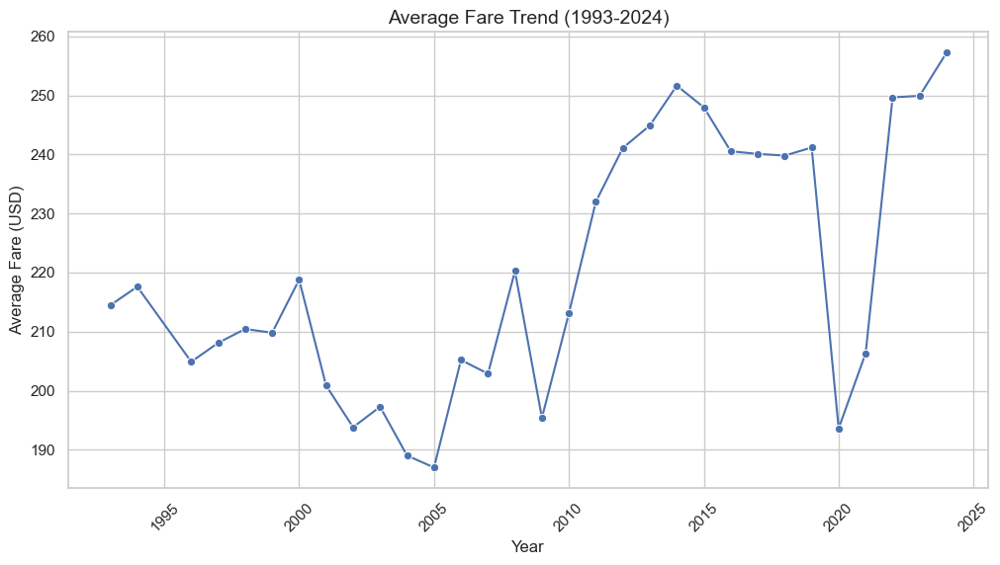

In [55]:
# Plot fare trend over years
plt.figure(figsize=(12, 6))
sns.lineplot(data=fare_trend, x="year", y="average_fare", marker="o", color="b")
plt.title("Average Fare Trend (1993-2024)", fontsize=14)
plt.xlabel("Year", fontsize=12)
plt.ylabel("Average Fare (USD)", fontsize=12)
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

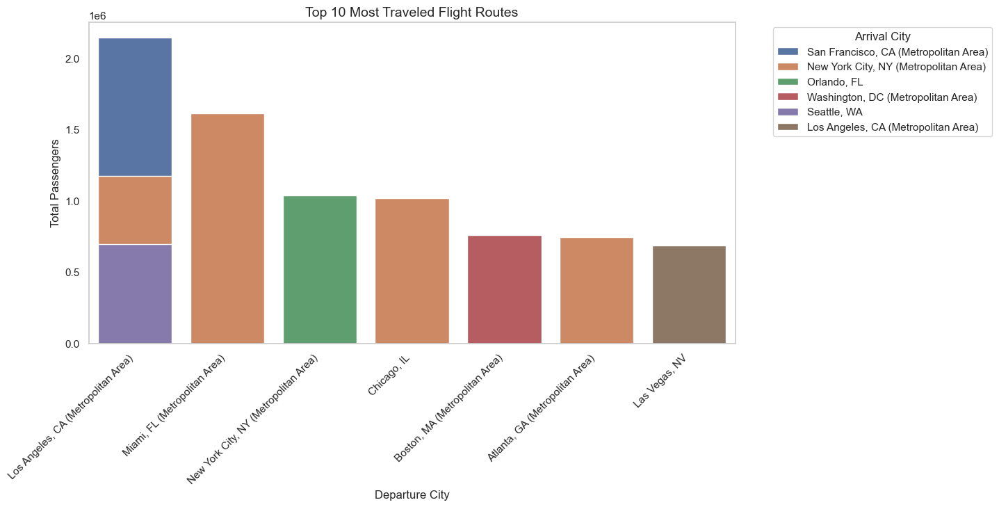

In [56]:
# Aggregate passenger volume by route
top_routes = df_cleaned.groupby(["departure_city", "arrival_city"])["passengers"].sum().reset_index()

# Get the top 10 most traveled routes
top_routes = top_routes.sort_values(by="passengers", ascending=False).head(10)

# Plot the most traveled routes
plt.figure(figsize=(12, 6))
sns.barplot(data=top_routes, y="passengers", x="departure_city", hue="arrival_city", dodge=False)
plt.title("Top 10 Most Traveled Flight Routes", fontsize=14)
plt.xlabel("Departure City", fontsize=12)
plt.ylabel("Total Passengers", fontsize=12)
plt.xticks(rotation=45, ha="right")
plt.legend(title="Arrival City", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.grid(axis="y")

plt.show()

In [57]:
# Load the cleaned dataset
file_path = Path("Data/cleaned_flight_data_v2.csv")
df = pd.read_csv(file_path)

In [58]:
# Group by year and quarter, calculating key statistics
quarterly_stats = df.groupby(["year", "quarter"]).agg(
    average_fare=("average_fare", "mean"),
    total_passengers=("passengers", "sum"),
    largest_market_share=("largest_carrier_market_share", "mean"),
    low_fare_market_share=("low_fare_market_share", "mean")
).reset_index()

In [59]:
# Display the first few rows
quarterly_stats.head()

,year,quarter,average_fare,total_passengers,largest_market_share,low_fare_market_share
0,1993,1,236.600889,345741,0.648664,0.428768
1,1993,2,209.415905,403857,0.641838,0.422033
2,1993,3,198.870923,393045,0.653791,0.437410
3,1993,4,213.500246,395495,0.642421,0.420185
4,1994,1,217.611944,397667,0.629556,0.419332


In [60]:
# Save results to a CSV file
quarterly_stats.to_csv("quarterly_flight_statistics.csv", index=False)

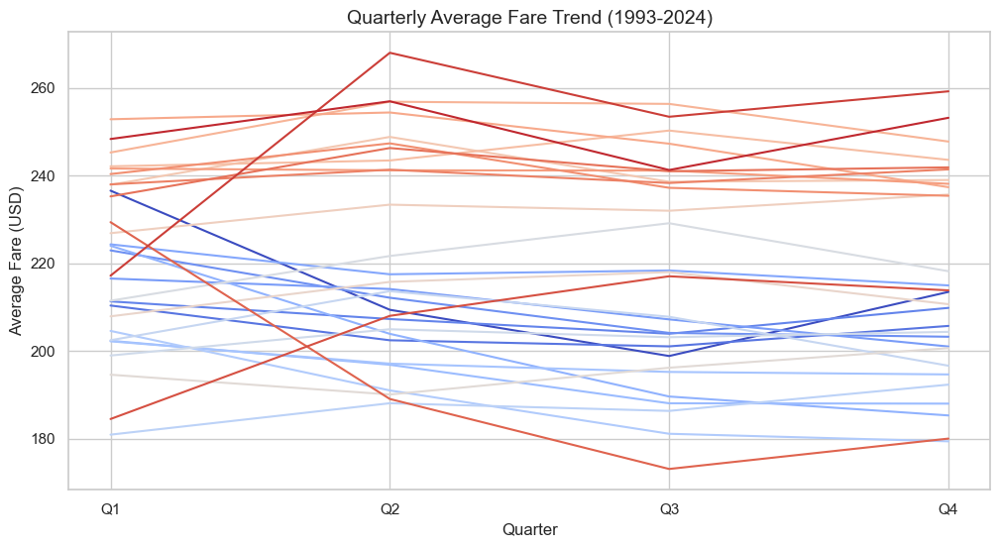

In [61]:
# Plot average fare trends over quarters
plt.figure(figsize=(12, 6))
sns.lineplot(data=quarterly_stats, x="quarter", y="average_fare", hue="year", palette="coolwarm", legend=False)
plt.title("Quarterly Average Fare Trend (1993-2024)", fontsize=14)
plt.xlabel("Quarter", fontsize=12)
plt.ylabel("Average Fare (USD)", fontsize=12)
plt.xticks([1, 2, 3, 4], ["Q1", "Q2", "Q3", "Q4"])
plt.grid(True)
plt.show()

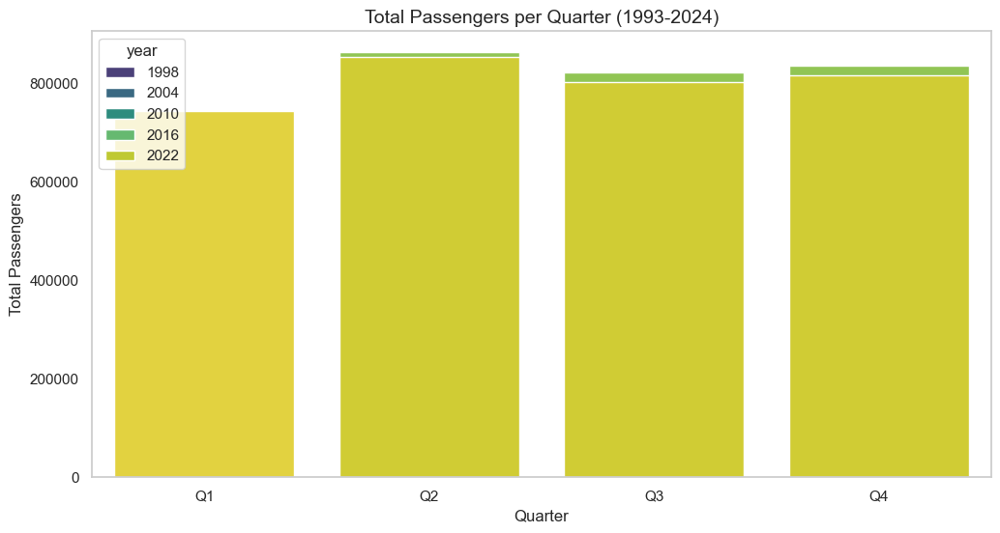

In [62]:
#Total passengers per quarter (1993-2024)
plt.figure(figsize=(12, 6))
sns.barplot(data=quarterly_stats, x="quarter", y="total_passengers", hue="year", palette="viridis", dodge=False)
plt.title("Total Passengers per Quarter (1993-2024)", fontsize=14)
plt.xlabel("Quarter", fontsize=12)
plt.ylabel("Total Passengers", fontsize=12)
plt.xticks([0, 1, 2, 3], ["Q1", "Q2", "Q3", "Q4"])
plt.grid(axis="y")
plt.show()


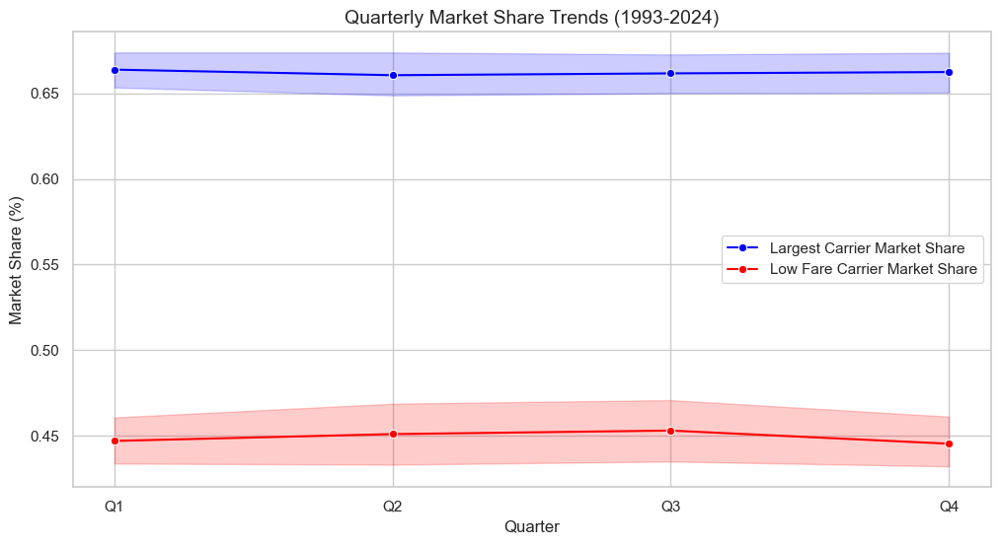

In [63]:
# Quarterly Market share trends (1993-2024)
plt.figure(figsize=(12, 6))
sns.lineplot(data=quarterly_stats, x="quarter", y="largest_market_share", label="Largest Carrier Market Share", marker="o", color="blue")
sns.lineplot(data=quarterly_stats, x="quarter", y="low_fare_market_share", label="Low Fare Carrier Market Share", marker="o", color="red")
plt.title("Quarterly Market Share Trends (1993-2024)", fontsize=14)
plt.xlabel("Quarter", fontsize=12)
plt.ylabel("Market Share (%)", fontsize=12)
plt.xticks([1, 2, 3, 4], ["Q1", "Q2", "Q3", "Q4"])
plt.legend()
plt.grid(True)
plt.show()


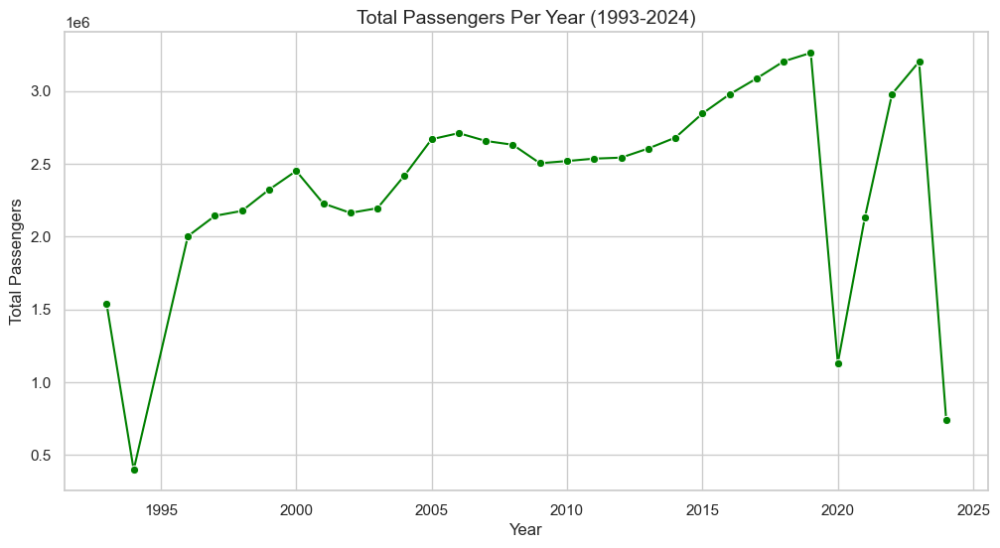

In [64]:
#Yearly Passenger volume trends
plt.figure(figsize=(12, 6))
sns.lineplot(data=df_cleaned.groupby("year")["passengers"].sum().reset_index(), x="year", y="passengers", marker="o", color="green")
plt.title("Total Passengers Per Year (1993-2024)", fontsize=14)
plt.xlabel("Year", fontsize=12)
plt.ylabel("Total Passengers", fontsize=12)
plt.grid(True)
plt.show()


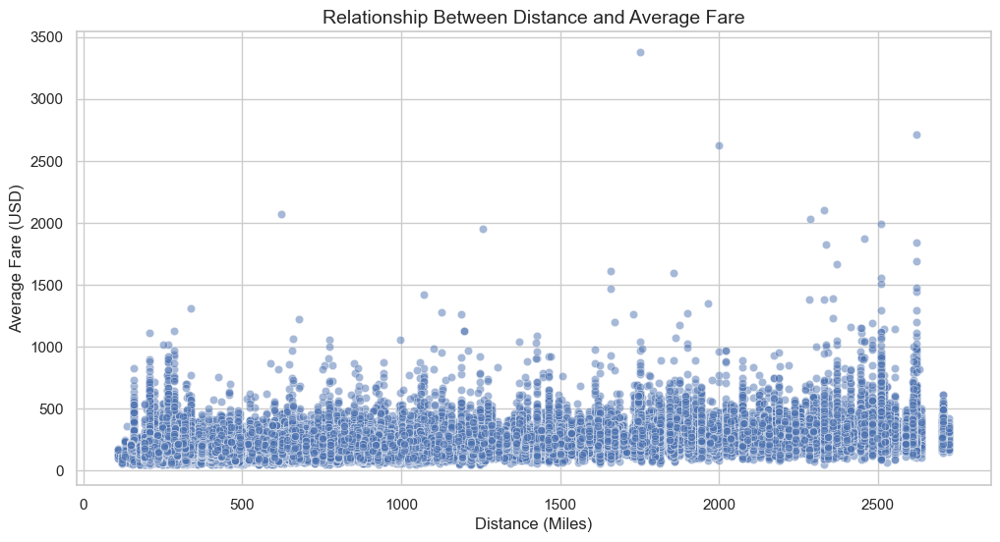

In [65]:
# Price vs. Distance Analysis
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df_cleaned, x="distance_miles", y="average_fare", alpha=0.5)
plt.title("Relationship Between Distance and Average Fare", fontsize=14)
plt.xlabel("Distance (Miles)", fontsize=12)
plt.ylabel("Average Fare (USD)", fontsize=12)
plt.grid(True)
plt.show()

/var/folders/j1/3lk4c0b17lxc6lhdy94ylbw80000gn/T/ipykernel_11334/3958360729.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(y=top_airlines.index, x=top_airlines.values, palette="coolwarm")


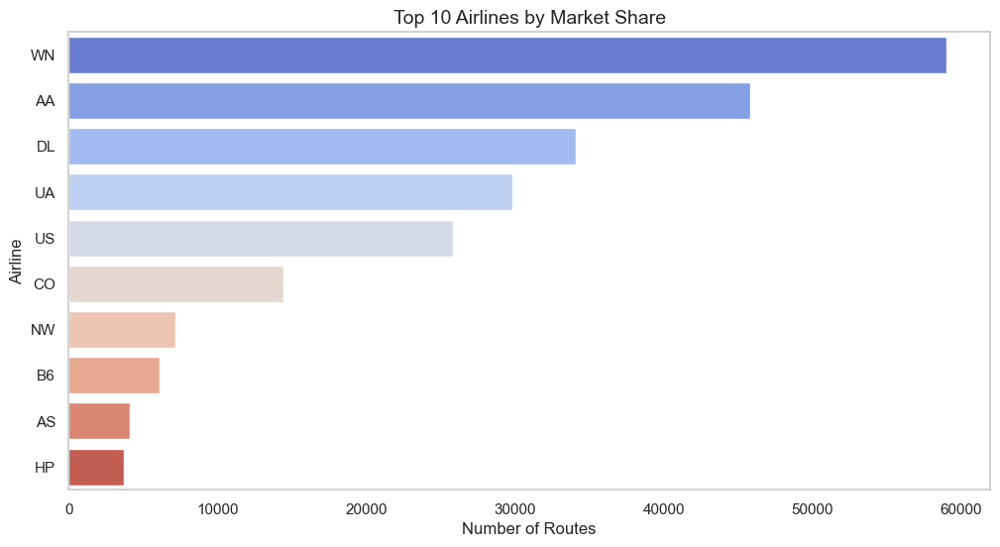

In [66]:
#Top 10 airlines by market share
top_airlines = df_cleaned["largest_carrier"].value_counts().head(10)

plt.figure(figsize=(12, 6))
sns.barplot(y=top_airlines.index, x=top_airlines.values, palette="coolwarm")
plt.title("Top 10 Airlines by Market Share", fontsize=14)
plt.xlabel("Number of Routes", fontsize=12)
plt.ylabel("Airline", fontsize=12)
plt.grid(axis="x")
plt.show()


In [67]:
# Cheapest routes
cheapest_routes = df_cleaned.nsmallest(10, "average_fare")[["departure_city", "arrival_city", "average_fare"]]
cheapest_routes



,departure_city,arrival_city,average_fare
35810,"Dallas/Fort Worth, TX","Washington, DC (Metropolitan Area)",50.00
42192,"Chicago, IL","Wichita, KS",50.40
147220,"Dallas/Fort Worth, TX","St. Louis, MO",50.41
131112,"Chicago, IL","Detroit, MI",50.50
127830,"Dallas/Fort Worth, TX","Los Angeles, CA (Metropolitan Area)",50.72
114736,"Cleveland, OH (Metropolitan Area)","New York City, NY (Metropolitan Area)",50.80
140699,"Charlotte, NC","Washington, DC (Metropolitan Area)",50.80
170482,"Dallas/Fort Worth, TX","St. Louis, MO",50.96
16430,"Reno, NV","San Francisco, CA (Metropolitan Area)",50.98
96563,"Reno, NV","San Francisco, CA (Metropolitan Area)",50.98


In [68]:
# Most expensive routes
expensive_routes = df_cleaned.nlargest(10, "average_fare")[["departure_city", "arrival_city", "average_fare"]]
expensive_routes

,departure_city,arrival_city,average_fare
144393,"Chicago, IL","Portland, OR",3377.00
90359,"New York City, NY (Metropolitan Area)","San Francisco, CA (Metropolitan Area)",2716.00
149545,"Detroit, MI","Los Angeles, CA (Metropolitan Area)",2628.90
94012,"Los Angeles, CA (Metropolitan Area)","Washington, DC (Metropolitan Area)",2104.90
74780,"Chicago, IL","Washington, DC (Metropolitan Area)",2074.00
137194,"Reno, NV","Washington, DC (Metropolitan Area)",2034.35
17674,"Los Angeles, CA (Metropolitan Area)","New York City, NY (Metropolitan Area)",1991.00
91821,"Boston, MA (Metropolitan Area)","Kansas City, MO",1950.00
43531,"San Francisco, CA (Metropolitan Area)","Washington, DC (Metropolitan Area)",1871.00
96875,"New York City, NY (Metropolitan Area)","San Francisco, CA (Metropolitan Area)",1841.70


/var/folders/j1/3lk4c0b17lxc6lhdy94ylbw80000gn/T/ipykernel_11334/2920138504.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_cleaned, x="quarter", y="average_fare", palette="coolwarm")


([<matplotlib.axis.XTick at 0x31b2b08c0>], [Text(0, 0, '1')])

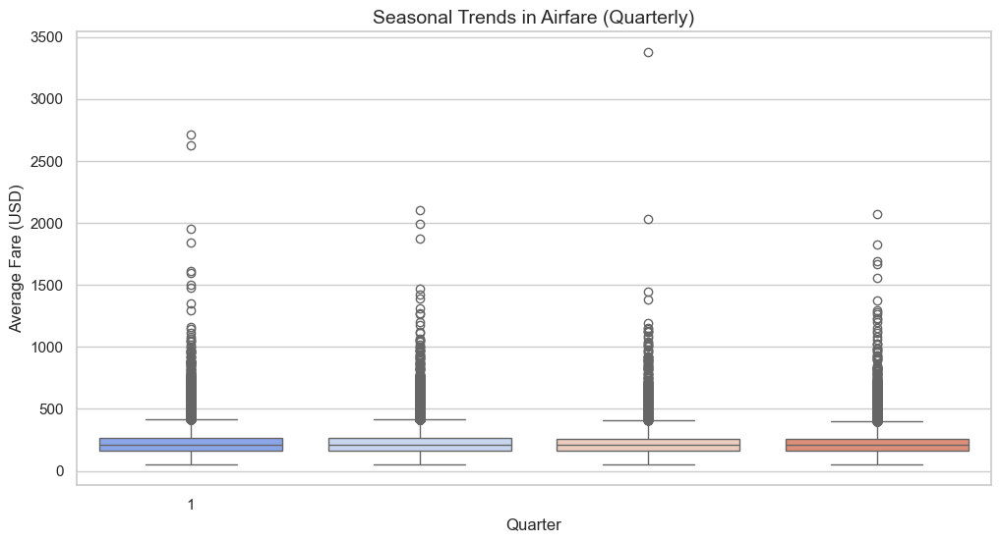

In [69]:
#Seasonal Trends in airfare (quarterly)
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_cleaned, x="quarter", y="average_fare", palette="coolwarm")
plt.title("Seasonal Trends in Airfare (Quarterly)", fontsize=14)
plt.xlabel("Quarter", fontsize=12)
plt.ylabel("Average Fare (USD)", fontsize=12)
plt.xticks([0])


/var/folders/j1/3lk4c0b17lxc6lhdy94ylbw80000gn/T/ipykernel_11334/949637396.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=filtered_df, x="departure_airport", y="average_fare", palette="magma")


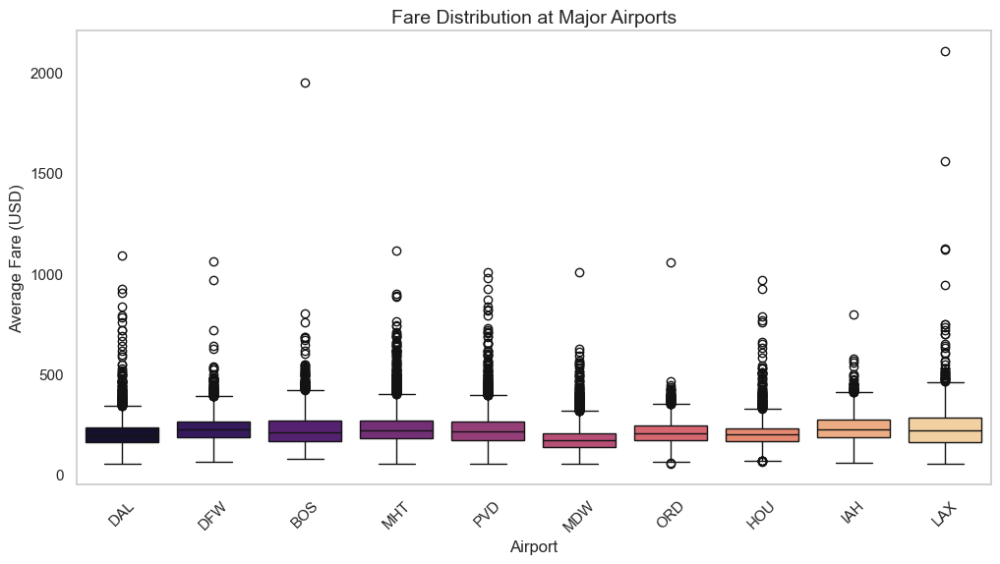

In [70]:
#Fare distribution at major airports
top_airports = df["departure_airport"].value_counts().head(10).index
filtered_df = df[df["departure_airport"].isin(top_airports)]

plt.figure(figsize=(12, 6))
sns.boxplot(data=filtered_df, x="departure_airport", y="average_fare", palette="magma")
plt.xticks(rotation=45)
plt.title("Fare Distribution at Major Airports", fontsize=14)
plt.xlabel("Airport", fontsize=12)
plt.ylabel("Average Fare (USD)", fontsize=12)
plt.grid(axis="y")
plt.show()


/var/folders/j1/3lk4c0b17lxc6lhdy94ylbw80000gn/T/ipykernel_11334/2522086414.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_airlines.values, y=top_airlines.index, palette="coolwarm")


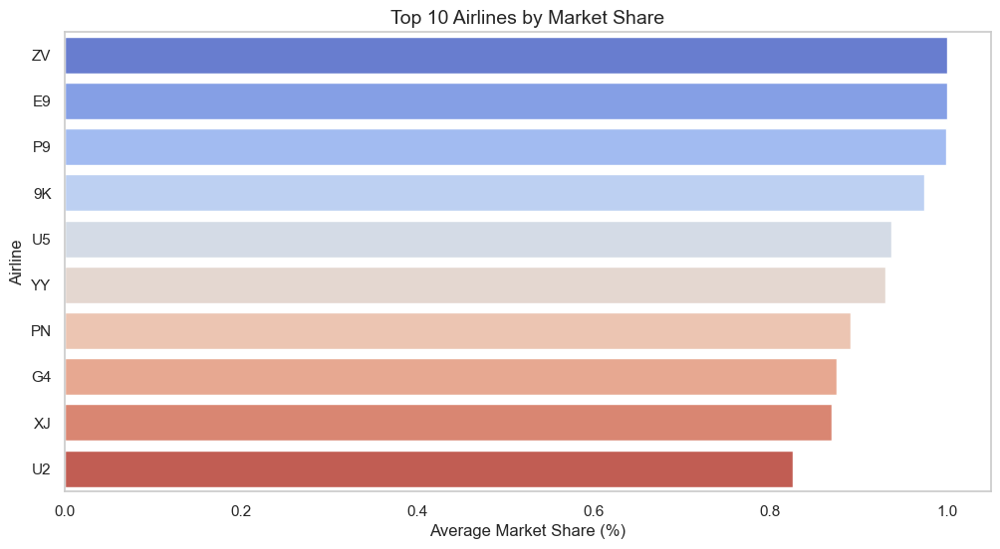

In [71]:
#Top 10 airlines by market share
top_airlines = df.groupby("largest_carrier")["largest_carrier_market_share"].mean().sort_values(ascending=False).head(10)

plt.figure(figsize=(12, 6))
sns.barplot(x=top_airlines.values, y=top_airlines.index, palette="coolwarm")
plt.title("Top 10 Airlines by Market Share", fontsize=14)
plt.xlabel("Average Market Share (%)", fontsize=12)
plt.ylabel("Airline", fontsize=12)
plt.grid(axis="x")
plt.show()


In [74]:
# Load the datasets
df  = pd.read_csv('Data/CSV/cleaned_flight_data.csv')

In [75]:
df

,tbl,Year,quarter,departure_city_id,arrival_city_id,departure_city,arrival_city,departure_airport_id,arrival_airport_id,departure_airport,...,large_ms,fare_lg,carrier_low,lf_ms,fare_low,tbl1apk,departure_latitude,departure_longitude,arrival_latitude,arrival_longitude
0,Table 1a,2010,1,34614,33195,"Salt Lake City, UT","Tampa, FL (Metropolitan Area)",14869,15304,SLC,...,0.3800,247.69,US Airways Group Inc.,0.2000,166.99,201011486915304SLCTPA,40.758478,-111.888142,37.860600,-78.804199
1,Table 1a,1998,4,30189,31703,"Colorado Springs, CO","New York City, NY (Metropolitan Area)",11109,12197,COS,...,0.7300,292.60,Northwest Airlines Inc.,0.2400,248.27,199841110912197COSHPN,38.835224,-104.819798,40.123164,-75.333718
2,Table 1a,1998,4,30198,30852,"Pittsburgh, PA","Washington, DC (Metropolitan Area)",14122,10821,PIT,...,0.9300,245.70,Continental Airlines Inc.,0.0300,71.30,199841412210821PITBWI,40.442169,-79.994945,38.892062,-77.019912
3,Table 1a,2009,3,32211,32575,"Las Vegas, NV","Los Angeles, CA (Metropolitan Area)",12889,14908,LAS,...,0.5800,118.28,US Airways Group Inc.,0.4100,102.75,200931288914908LASSNA,36.169202,-115.140597,34.052238,-118.243344
4,Table 1a,1993,4,30255,30852,"Huntsville, AL","Washington, DC (Metropolitan Area)",12217,12264,HSV,...,0.4800,275.50,United Air Lines Inc.,0.2500,197.69,199341221712264HSVIAD,34.729538,-86.585283,38.892062,-77.019912
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205184,Table1a,2020,2,35412,33195,"Knoxville, TN","Tampa, FL (Metropolitan Area)",15412,15304,TYS,...,0.9014,197.87,American Airlines Inc.,0.9014,197.87,202021541215304TYSTPA,35.962631,-83.916677,37.860600,-78.804199
205185,Table1a,2020,2,31834,32575,"Fayetteville, AR","Los Angeles, CA (Metropolitan Area)",15919,10800,XNA,...,1.0000,252.00,American Airlines Inc.,1.0000,252.00,202021591910800XNABUR,36.061928,-94.160583,34.052238,-118.243344
205186,Table1a,2020,2,31834,32575,"Fayetteville, AR","Los Angeles, CA (Metropolitan Area)",15919,12892,XNA,...,0.5610,90.05,Allegiant Air,0.5610,90.05,202021591912892XNALAX,36.061928,-94.160583,34.052238,-118.243344
205187,Table1a,2020,2,31834,32575,"Fayetteville, AR","Los Angeles, CA (Metropolitan Area)",15919,13891,XNA,...,0.9683,191.31,American Airlines Inc.,0.9683,191.31,202021591913891XNAONT,36.061928,-94.160583,34.052238,-118.243344


In [76]:
df.columns

Index(['tbl', 'Year', 'quarter', 'departure_city_id', 'arrival_city_id',
       'departure_city', 'arrival_city', 'departure_airport_id',
       'arrival_airport_id', 'departure_airport', 'arrival_airport', 'nsmiles',
       'passengers', 'fare', 'carrier_lg', 'large_ms', 'fare_lg',
       'carrier_low', 'lf_ms', 'fare_low', 'tbl1apk', 'departure_latitude',
       'departure_longitude', 'arrival_latitude', 'arrival_longitude'],
      dtype='object')

In [77]:

# Calculate total number of flights
total_flights = len(df)

# Print the result
print(f"Total number of flights: {total_flights}")


Total number of flights: 205189


In [78]:
departure_airport = df['departure_airport'].unique()
print(len(departure_airport))

178


In [79]:
departure_city = df['departure_city'].unique()
print(len(departure_city))

136


In [80]:
Top_carrier_low = df['departure_city'].value_counts().head(10)
Top_carrier_low

departure_city
Los Angeles, CA (Metropolitan Area)      21527
New York City, NY (Metropolitan Area)    19718
Boston, MA (Metropolitan Area)           19674
Chicago, IL                              15546
Dallas/Fort Worth, TX                    12142
Houston, TX                              11317
Cleveland, OH (Metropolitan Area)         7697
Miami, FL (Metropolitan Area)             6746
Atlanta, GA (Metropolitan Area)           3516
Detroit, MI                               3390
Name: count, dtype: int64

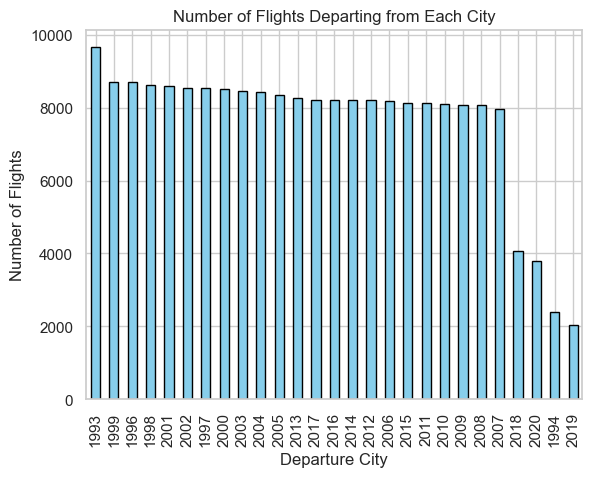

In [81]:

# Counting occurrences of each unique value in the 'departure_city' column
count = df['Year'].value_counts()

# Plotting the bar chart
count.plot(kind='bar', color='skyblue', edgecolor='black')

# Adding labels and title
plt.title('Number of Flights Departing from Each City')
plt.xlabel('Departure City')
plt.ylabel('Number of Flights')

# Displaying the chart
# Save the plot as a .png file
plt.savefig('Data/Images/Number_of_Flights_Departing_from_Each_City.png')

In [82]:
arrival_airport =df['arrival_airport'].unique()
print(len(arrival_airport))

163


In [83]:
arrival_city = df['arrival_city'].unique()
print(len(arrival_city))

121


In [84]:
Top_arrival_city = df['arrival_city'].value_counts().head(10)
Top_arrival_city

arrival_city
New York City, NY (Metropolitan Area)    31247
Washington, DC (Metropolitan Area)       26680
San Francisco, CA (Metropolitan Area)    18625
Los Angeles, CA (Metropolitan Area)      17555
Tampa, FL (Metropolitan Area)             7352
Miami, FL (Metropolitan Area)             7238
Houston, TX                               5321
Norfolk, VA (Metropolitan Area)           4686
Phoenix, AZ                               4158
Dallas/Fort Worth, TX                     3443
Name: count, dtype: int64

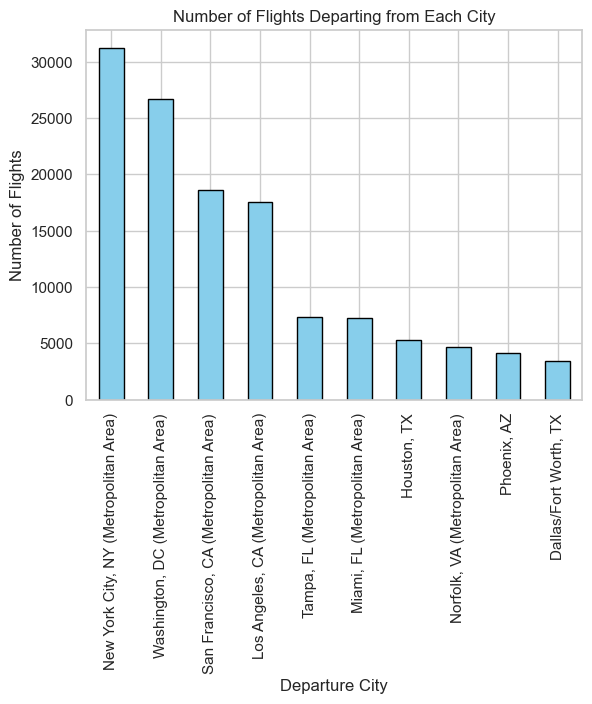

In [85]:

# Plotting the bar chart
Top_arrival_city.plot(kind='bar', color='skyblue', edgecolor='black')

# Adding labels and title
plt.title('Number of Flights Departing from Each City')
plt.xlabel('Departure City')
plt.ylabel('Number of Flights')

# Displaying the chart
# Save the plot as a .png file
plt.savefig('Data/Images/Number_of_Flights_Departing_from_Each_City_Top_10.png')

In [86]:
bottom_arrival_city = df['arrival_city'].value_counts().tail(5)
bottom_arrival_city

arrival_city
Punta Gorda, FL    2
Sanford, FL        1
Huntsville, AL     1
Rockford, IL       1
Fort Wayne, IN     1
Name: count, dtype: int64

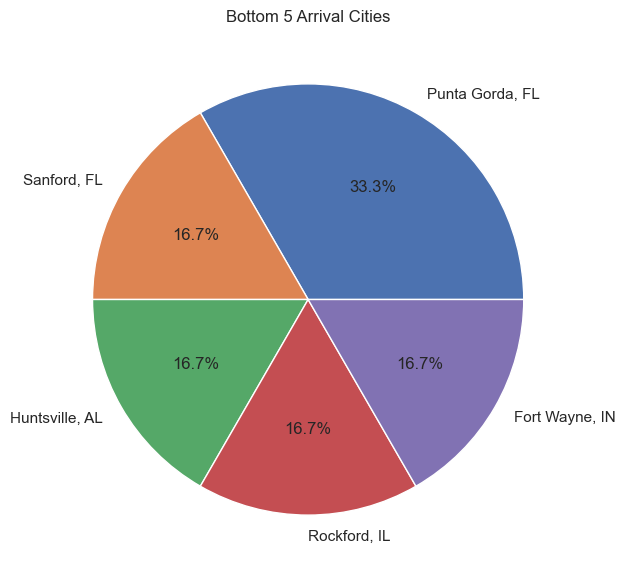

In [87]:

# Bottom 5 arrival cities
bottom_arrival_city = df['arrival_city'].value_counts().tail(5)

# Create pie chart
bottom_arrival_city.plot(kind='pie', autopct='%1.1f%%', figsize=(7, 7))

# Show the plot
plt.title('Bottom 5 Arrival Cities')
plt.ylabel('')  # Hide the y-label

# Save the plot as a .png file
plt.savefig('Data/Images/Bottom_5_Arrival_Cities.png')

In [88]:
Top_carrier_low = df['carrier_low'].value_counts().head(10)
Top_carrier_low

carrier_low
Southwest Airlines Co.         40663
American Airlines Inc.         28446
Delta Air Lines Inc.           27748
US Airways Group Inc.          24811
United Air Lines Inc.          17141
Continental Airlines Inc.      15936
Northwest Airlines Inc.         9728
AirTran Airways Corporation     7544
America West Airlines Inc.      6973
JetBlue Airways                 4922
Name: count, dtype: int64

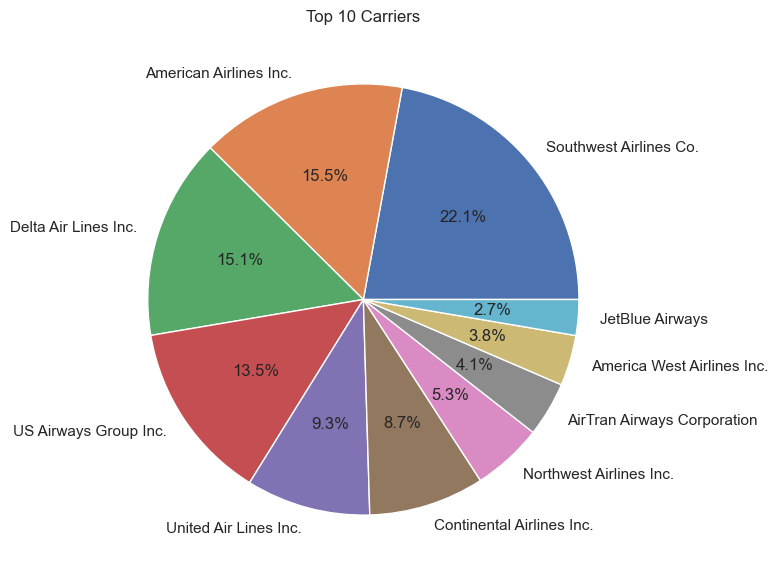

In [89]:

# Top 10 carriers (most frequent)
Top_carrier_low = df['carrier_low'].value_counts().head(10)

# Create pie chart
Top_carrier_low.plot(kind='pie', autopct='%1.1f%%', figsize=(7, 7))

# Show the plot
plt.title('Top 10 Carriers')
plt.ylabel('')  # Hide the y-label

# Save the plot as a .png file
plt.savefig('Data/Images/Top_10_Carriers.png')

In [90]:

# Sort the DataFrame by the 'fare_low' column in ascending order and get the first 10 rows
top_10_lowest_fares = df.sort_values(by='fare_low').head(10)

# Display the result
print("Top 10 lowest-cost flights:")
print(top_10_lowest_fares[['departure_city', 'carrier_low', 'fare_low']])


Top 10 lowest-cost flights:
                               departure_city                carrier_low  \
29392                   Dallas/Fort Worth, TX     Southwest Airlines Co.   
174885  New York City, NY (Metropolitan Area)     American Airlines Inc.   
35670                             Chicago, IL      United Air Lines Inc.   
138939                  Dallas/Fort Worth, TX     Southwest Airlines Co.   
123097                            Chicago, IL     Southwest Airlines Co.   
52238       Cleveland, OH (Metropolitan Area)                         DH   
186280    Los Angeles, CA (Metropolitan Area)            JetBlue Airways   
96861   New York City, NY (Metropolitan Area)  Continental Airlines Inc.   
44548                   Dallas/Fort Worth, TX     Southwest Airlines Co.   
119875                  Dallas/Fort Worth, TX     Southwest Airlines Co.   

        fare_low  
29392      50.00  
174885     50.10  
35670      50.40  
138939     50.41  
123097     50.50  
52238      50.50  
18

In [91]:
# Let's calculate the average price per airline
avg_fare_per_airline = df.groupby('carrier_low')['fare'].mean()

# Let's sort the airlines by the cheapest average price
print(avg_fare_per_airline.sort_values())



carrier_low
Hawaiian Airlines Inc.          81.670000
A7                              84.760000
Atlantic Southeast Airlines     95.842500
ZV                              96.200000
U2                              99.161429
                                  ...    
United Air Lines Inc.          241.653723
FF                             246.947414
LC                             247.636250
Virgin America                 251.409100
9K                             282.653846
Name: fare, Length: 69, dtype: float64


In [92]:
# Let's count how many times each airline has been preferred
airline_preference_count = df['carrier_low'].value_counts()

# Let's print the most preferred airline
print(airline_preference_count.head(1))  # Shows the most preferred airline



carrier_low
Southwest Airlines Co.    40663
Name: count, dtype: int64


In [93]:

# Let's group by years and calculate the average fare price
avg_fare_per_year = df.groupby('Year')['fare'].mean()

# Let's print the average fare prices
print(avg_fare_per_year)


Year
1993    212.823042
1994    215.698258
1996    202.443948
1997    206.226955
1998    208.694681
1999    208.787041
2000    217.779298
2001    199.939150
2002    193.162309
2003    196.300227
2004    188.276183
2005    186.614546
2006    204.918606
2007    202.549350
2008    219.812299
2009    195.146096
2010    212.829371
2011    231.864359
2012    240.743439
2013    244.822626
2014    251.501394
2015    247.813214
2016    240.530669
2017    240.081527
2018    239.671059
2019    241.082278
2020    210.240885
Name: fare, dtype: float64


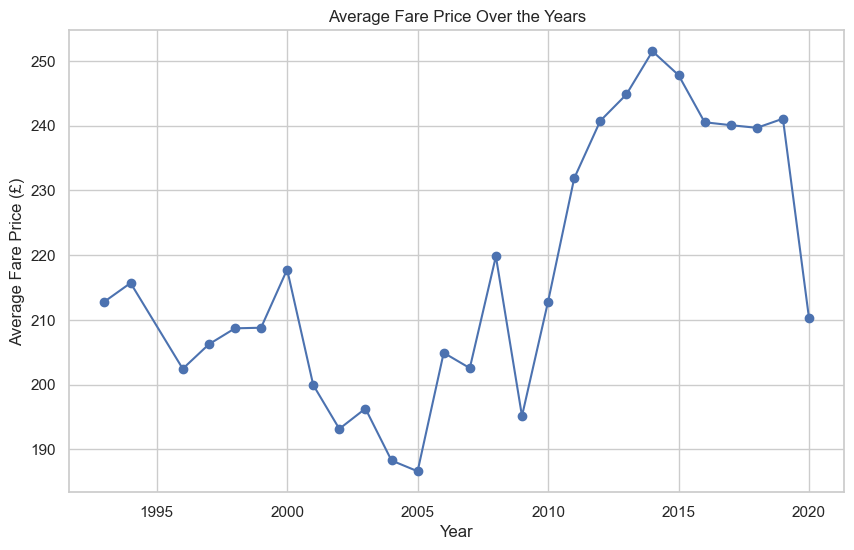

In [94]:
# Let's plot the average fare prices by year
plt.figure(figsize=(10, 6))
plt.plot(avg_fare_per_year.index, avg_fare_per_year.values, marker='o', linestyle='-', color='b')

# Add title and labels
plt.title('Average Fare Price Over the Years')
plt.xlabel('Year')
plt.ylabel('Average Fare Price (£)')
plt.grid(True)

# Save the plot as a .png file
plt.savefig('Data/Images/Average_Fare_Price_Over_the_Years.png')

In [95]:

# Let's create "dummy" variables to convert the categorical 'carrier_low' (airline company) into numerical data
df_dummies = pd.get_dummies(df['carrier_low'], drop_first=True)

# Let's combine the 'Year' column with the dummy variables
df_combined = pd.concat([df['Year'], df_dummies], axis=1)

# Let's calculate the correlation
correlation = df_combined.corr()

# Let's print the correlation between 'Year' and each airline company
print(correlation['Year'])



Year    1.000000
5J     -0.010028
9K      0.007520
9N     -0.014523
A7     -0.003062
          ...   
WV     -0.026792
XJ     -0.002761
YY     -0.003963
ZA     -0.004833
ZV     -0.000061
Name: Year, Length: 69, dtype: float64
